# **Introducción**

Inspirado por la película *Moneyball*, protagonizada por Brad Pitt como el entrenador de un equipo de béisbol de nivel medio pero con aspiraciones que aspiran a ganar la liga. En la cinta, basada en una historia real, estas aspiraciones lo lleva a aplicar técnicas de análisis de datos con el objetivo de encontrar futuras promesas que catapulten su equipo al estrellato (lo que, sin adelantar nada a aquel que quiera ver la película, puedo adelantar que pareció tener, como poco, algo de efecto).
<br>
<br>

Así, nos proponemos hoy analizar una base con datos referentes a 17 660 jugadores de la FIFA desde 2017 al 2023, caracterizados cada uno por diferentes métricas, desde deportivas hasta económmicas. 
<br>
¿Encontraremos alguna posible promesa? Solo hay una manera de descubrirlo, y es comenzando:

# Importo librerías

Primero de todo, importo las librerías y paquetes necesarios para el análisis que sigue:

In [1]:
# install.packages("tidyverse")
# install.packages("patchwork")
# install.packages("GGally")
# install.packages("nortest")

In [2]:
library(tidyverse)
library(patchwork)
library(GGally)
library(nortest)

# Master -> Detección de anomalías
# Juan Carlos Cubero. Universidad de Granada

library(ggplot2)
library(fitdistrplus)  # Ajuste de una distribución -> denscomp 
library(ggpubr)    # ggqqplot -para los gráficos QQ-
library(ggbiplot)  # biplot
library(outliers)  # Grubbs
library(MVN)       # mvn: Test de normalidad multivariante  
library(CerioliOutlierDetection)  #MCD Hardin Rocke
library(mvoutlier) # corr.plot 
library(DescTools) # lof
library(cluster)   # PAM
library(heplots)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.1     ✔ stringr   1.5.2
✔ ggplot2   4.0.1     ✔ tibble    3.3.0
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.1.0     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
Loading required package: MASS


Attaching package: ‘MASS’


The following object is masked from ‘package:patchwork’:

    area


The following object is masked from ‘package:dplyr’:

    select


Loading required package: survival

Loading required package: plyr

------------------------------------------------------------------------------

You have loaded plyr after dplyr - this is likely to cause problems.
If you need functions from both plyr and dplyr, please load pl

Así como las funciones diseñadas por el profesor:

In [3]:
source("./paquetes/OutliersFunciones_byCubero.R")

# Importo y preparo el dataset

Posteriormente, importo e inspecciono el dataset a analizar (fuente: https://www.kaggle.com/datasets/kevwesophia/fifa23-official-datasetclean-data):

In [4]:
(ds <- read.csv("data/CLEAN_FIFA23_official_data.csv") %>% dplyr::select(-"X")) %>% head(3)
colnames(ds)
dim(ds)

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club.Logo,⋯,Position,Joined,Loaned.From,Contract.Valid.Until,Height.cm..,Weight.lbs..,Release.Clause...,Kit.Number,Best.Overall.Rating,Year_Joined
,<int>,<chr>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,209658,L. Goretzka,27,https://cdn.sofifa.net/players/209/658/23_60.png,Germany,https://cdn.sofifa.net/flags/de.png,87,88,FC Bayern München,https://cdn.sofifa.net/teams/21/30.png,⋯,SUB,2018-07-01,None,2026,189,180.810,1.57e+08,8,0,2018
2,212198,Bruno Fernandes,27,https://cdn.sofifa.net/players/212/198/23_60.png,Portugal,https://cdn.sofifa.net/flags/pt.png,86,87,Manchester United,https://cdn.sofifa.net/teams/11/30.png,⋯,LCM,2020-01-30,None,2026,179,152.145,1.55e+08,8,0,2020
3,224334,M. Acuña,30,https://cdn.sofifa.net/players/224/334/23_60.png,Argentina,https://cdn.sofifa.net/flags/ar.png,85,85,Sevilla FC,https://cdn.sofifa.net/teams/481/30.png,⋯,LB,2020-09-14,None,2024,172,152.145,9.77e+07,19,0,2020


[1] "ID"                       "Name"                    
 [3] "Age"                      "Photo"                   
 [5] "Nationality"              "Flag"                    
 [7] "Overall"                  "Potential"               
 [9] "Club"                     "Club.Logo"               
[11] "Value..."                 "Wage..."                 
[13] "Special"                  "Preferred.Foot"          
[15] "International.Reputation" "Weak.Foot"               
[17] "Skill.Moves"              "Work.Rate"               
[19] "Body.Type"                "Real.Face"               
[21] "Position"                 "Joined"                  
[23] "Loaned.From"              "Contract.Valid.Until"    
[25] "Height.cm.."              "Weight.lbs.."            
[27] "Release.Clause..."        "Kit.Number"              
[29] "Best.Overall.Rating"      "Year_Joined"

[1] 17660    30

Por lo que, como se ha dicho al inicio, manejamos una base de datos con 17 660 muestras, cada una correspondiente a un jugador de fútbol, caracterizadas por 30 atributos diferentes. Sin embargo, gran parte de ellos, como lo son `Photo` o `Nationality` no son muy interesantes para el análisis.

Así, nos quedaremos principalmente con las variables numéricas, junto con aquella referente al pie bueno del jugador (`Preferred.Foot`) y su posición en el campo (`Position`).

<br>
Pd: guardamos esas últimas dos variables por el posible interés que pudea haber por analizar el dataset por grupos.

In [5]:
(ds <- ds %>% dplyr::select(-c("ID", "Photo", "Flag", "Nationality", "Club", "Club.Logo", 'Contract.Valid.Until', "Joined", "Work.Rate", "Body.Type", "Real.Face", "Loaned.From", "Year_Joined", 'Kit.Number', "International.Reputation", "Best.Overall.Rating"))) %>% head(3)

,Name,Age,Overall,Potential,Value...,Wage...,Special,Preferred.Foot,Weak.Foot,Skill.Moves,Position,Height.cm..,Weight.lbs..,Release.Clause...
,<chr>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>
1,L. Goretzka,27,87,88,91000000,115000,2312,Right,4,3,SUB,189,180.810,1.57e+08
2,Bruno Fernandes,27,86,87,78500000,190000,2305,Right,3,4,LCM,179,152.145,1.55e+08
3,M. Acuña,30,85,85,46500000,46000,2303,Left,3,3,LB,172,152.145,9.77e+07


Y reordeno el dataset para poner las todas (serían tres) variables categóricas al inicio del mismo. Además, las convertimos a factores:

In [6]:
ds <- ds %>% dplyr::select("Name","Position", "Preferred.Foot", everything())
(ds <- ds %>% mutate(
    Name=factor(Name), 
    Preferred.Foot=factor(Preferred.Foot), 
    Position=factor(Position))) %>% head(3)
dim(ds)

,Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...
,<fct>,<fct>,<fct>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,L. Goretzka,SUB,Right,27,87,88,91000000,115000,2312,4,3,189,180.810,1.57e+08
2,Bruno Fernandes,LCM,Right,27,86,87,78500000,190000,2305,3,4,179,152.145,1.55e+08
3,M. Acuña,LB,Left,30,85,85,46500000,46000,2303,3,3,172,152.145,9.77e+07


[1] 17660    14

Nuestro conjunto de datos, se compone, pues, de las siguientes variables:
- `Name`: nombre del futbolista.

- `Position`: posición del futbolista en el campo.

- `Preferred.Foot`: pie bueno.

- `Age`: edad.

- `Overall`: valoración media global.

- `Potential`: valoración a futuro.

- `Value`: precio de compra del deportista.

- `Wage`: salario.

- `Special`: valor numérico representativo de las habilidades especiales del jugador.

- `Weak.Foot`: valor representativo de la habilidad del jugador con su pie débil.

- `Skill.Moves`: número de movimientos especiales que el jugador posee.

- `Height.cm..`: altura en centímetros.

- `Weight.lbs..`: peso en libras.

- `Release.Clause...`: precio para terminar el contrato del jugador previamente a la fecha especificada.

- `Best.Overall.Rating`: la mejor valoración media global otorgada al jugador. 

# Inspecciono el dataset

Inspeccionemos, a continuación, la distribución de las variables a manejar:

In [10]:
tema_custom <- (theme_bw(base_size = 24) +   # big base size
    theme(
        strip.text = element_text(size = 26, face = "bold"),     # facet titles
        axis.title = element_text(size = 24, face = "bold"),     # axis labels
        axis.text  = element_text(size = 20, face = "bold"),     # tick labels
        plot.title = element_text(size = 28, face = "bold"),     # main title
        legend.text = element_text(size = 20, face = "bold"),
        legend.title = element_text(size = 22, face = "bold")
    ))

Primero las variables numéricas:

## **Método IQR**

Inicialmente buscaremos aquellos valores calificados como outliers según el método IQR. Esto se hará con todas aquellas variables no referentes al precio (pues, como se ha dicho antes, parecen distribuirse de manera similar a una normal).

In [130]:
ds %>% head(1)

,Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...
,<fct>,<fct>,<fct>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,L. Goretzka,SUB,Right,27,87,88,9.1e+07,115000,2312,4,3,189,180.81,1.57e+08


In [54]:
not_normal_var_idx <- c(1, 2, 3, 7, 8, 14) 
quasi_normal_var_idx <- setdiff(1:length(ds), not_normal_var_idx)

In [53]:
quantiles_IQR_analysis <- function(x){
  quants <- quantile(x, c(0.25,0.75))
  q25 <- as.numeric(quants[1])
  q75 <- as.numeric(quants[2])
  iqr <- q75-q25

  sup_o <- q75 + 1.5*iqr # Límite superior para calificar como outlier
  sup_oe <- q75 + 3.0*iqr # Límite superior para calificar como outlier extremo

  inf_o <- q25 - 1.5*iqr # Límite inferior para calificar como outlier
  inf_oe <- q25 - 3.0*iqr # Límite inferior para calificar como outlier extremo

  son_o <- (x<inf_o)|(x>sup_o)  #Son ourtliers
  son_oe <- (x<inf_oe)|(x>sup_oe)  #Son ourtliers extremos

  #Retorno una lista con todos los datos
  list(
    iqr=iqr,
    cuartil.primero=q25,
    cuartil.tercero=q75,
    extremo.superior.IQR=sup_o,
    extremo.inferior.IQR=inf_o,
    extremo.superior.IQR.extremo=sup_oe,
    extremo.inferior.IQR.extremo=inf_oe,
    son.outliers.IQR=son_o,
    son.outliers.IQR.extremos=son_oe
  )
}

In [55]:
vars_to_analyze_iqr <- colnames(ds)[-(1:3)]
cat(
    "Variables a analizar mediante método IQR:\n",
    rep("-",17),"\n")
cat(paste(vars_to_analyze_iqr, collapse=", "))

Variables a analizar mediante método IQR:
 - - - - - - - - - - - - - - - - - 
Age, Overall, Potential, Value..., Wage..., Special, Weak.Foot, Skill.Moves, Height.cm.., Weight.lbs.., Release.Clause...

In [56]:
vars_iqr_analysis <- lapply(
    X=vars_to_analyze_iqr,
    FUN=\(var_name){
        quantiles_IQR_analysis(ds %>% pull(var_name))
    })
names(vars_iqr_analysis) <- vars_to_analyze_iqr

### Análisis variable a variable

Warning message:
“Removed 1613 rows containing non-finite outside the scale range
(`stat_boxplot()`).”


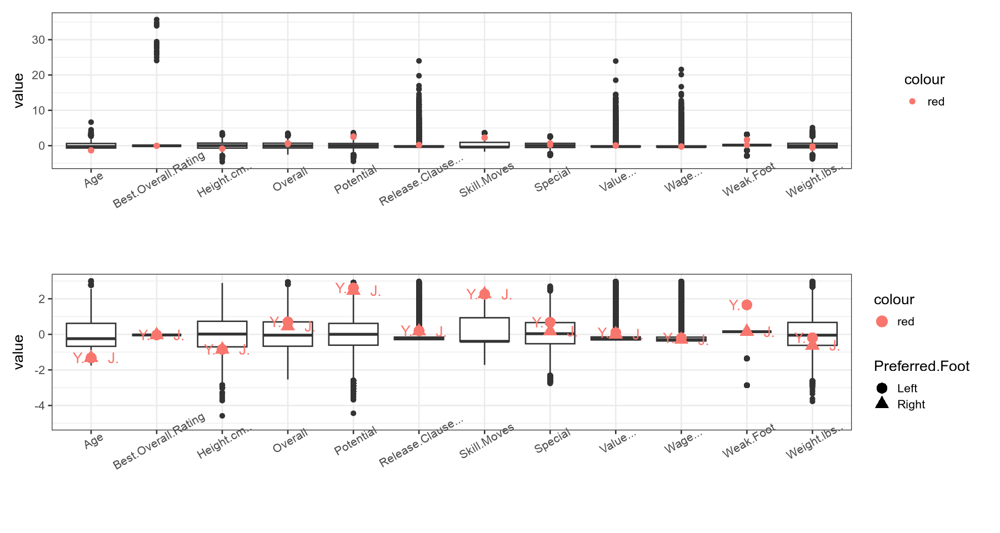

In [58]:
options(repr.plot.width=15, repr.plot.height=8)
p1 <- std_ds %>% pivot_longer(cols=-(1:3)) %>%
  ggplot(aes(x=name, y=value)) +
  geom_boxplot() +
  geom_point(data = std_promesas %>% pivot_longer(cols=-(1:3)), mapping=aes(color="red"))+
  theme_bw(base_size = 16) + theme(axis.text.x = element_text(angle=30)) +
  labs(x="")

p2 <- std_ds %>% pivot_longer(cols=-(1:3)) %>%
  ggplot(aes(x=name, y=value)) +
  geom_boxplot() +
  geom_point(data = std_promesas %>% pivot_longer(cols=-(1:3)), mapping=aes(color="red", shape=Preferred.Foot), size=5) +
  geom_text(data = std_promesas %>% pivot_longer(cols=-(1:3)), mapping=aes(color="red", label=str_sub(Name,1,2), hjust=ifelse(str_sub(Name,1,2)=="Y.", 1.5,-1.5)))+
  theme_bw(base_size = 16) + theme(axis.text.x = element_text(angle=30)) +
  scale_y_continuous(limits=c(-5, 3))+
  labs(x="")


wrap_plots(c(p1,p2), ncol=1)

Con lo que observamos que los dos jugadores anteriores comparten gran parte de sus atributos.

Otros datos relevantes que extraemos del gráfico anterior:
- Ambos tienen un peso algo menor al mediano, lo que puede llegar a permitírles una mayor velocidad que la media.
- A mi parecer, Y. Moukoko es un jugador aún más interesante que J. Bynoe-Gittens, pues el primero es el único zurdo de los dos, con, además, un control de su pierna débil máximo (cumple que `Weak.Foot`=5), a la par que cuenta con un porcentaje algo mayor en `Special`, donde el segundo jugador tiene un valor medio. 

## **Métodos estadísticos unidimensionales**

A continuación analizaremos los posibles outliers unidimensionales que nuestro dataset pueda tener basándonos en métodos estadísticos.

### Análisis de normalidad

Puesto que los test estadísticos a usar en este apartado requieren de que la distribución subyacente sin outliers siga una distribución normal, inicialmente comprobaremos si nuestras distribuciones cumplen lo anterior mediante métodos gráficos (comparación histograma-densidad y qq-plots) y estadísticos. Como hipótesis inicial, descartaremos solo aquellas medidas clasificadas como outliers extremos según el método IQR.

#### Métodos gráficos

- **Visualización histogramas**

In [121]:
options(repr.plot.width=6, repr.plot.height=5)
histograms <- lapply(
    X=colnames(ds)[-(1:3)], 
    FUN = \(varName){
        filtered_data <- ds[!vars_iqr_analysis[[varName]]$son.outliers.IQR.extremos, ] %>% pull(varName)
        denscomp(fitdist(filtered_data , "norm"), plotstyle = "ggplot", main="", xlab=varName)
        }
    )

Warning message in cov2cor(varcovar):
“diag(V) had non-positive or NA entries; the non-finite result may be dubious”
Warning message in sqrt(diag(varcovar)):
“NaNs produced”
Warning message in cov2cor(varcovar):
“diag(V) had non-positive or NA entries; the non-finite result may be dubious”
Warning message in sqrt(diag(varcovar)):
“NaNs produced”
Warning message in cov2cor(varcovar):
“diag(V) had non-positive or NA entries; the non-finite result may be dubious”
Warning message in sqrt(diag(varcovar)):
“NaNs produced”


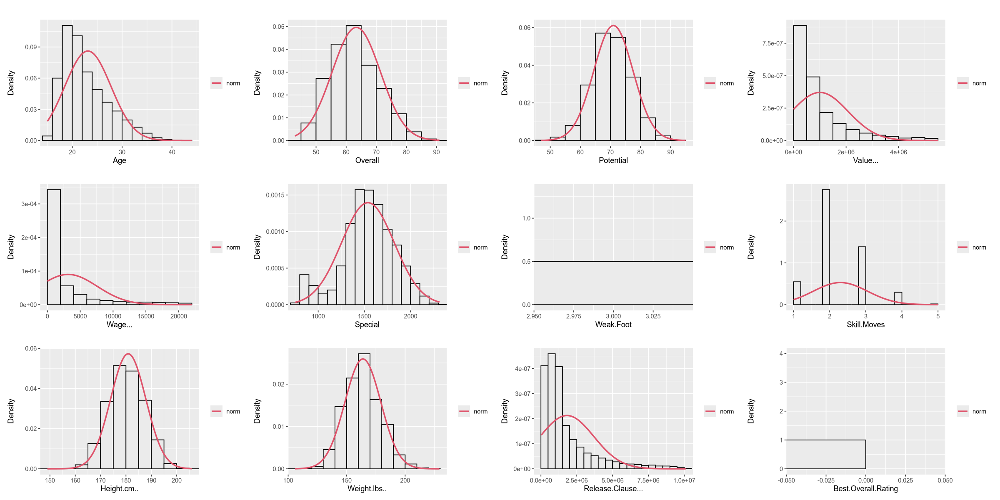

In [122]:
options(repr.plot.width=20, repr.plot.height=10)
wrap_plots(histograms, ncol=4)

Con lo que a simple vista observamos que en general todas las variables parecen tener un comportamiento no muy raro, a excepción de:
- Las variables discretas `WeakFoot` y `Skill.Moves`.
- Las variables referentes a dinero, que, por su caracter muy desigual, pese a no alejarse extremadamente de la tendencia normal, si lo hacen lo suficiente como para, a simple vista, descartar que se distribuyan de tal forma.

- **QQ-plots**

In [17]:
options(repr.plot.width=6, repr.plot.height=5)
qqplots <- lapply(
    X=colnames(ds)[-(1:3)], 
    FUN = \(varName){
        filtered_data <- ds[!vars_iqr_analysis[[varName]]$son.outliers.IQR.extremos, ] %>% pull(varName)
        ggqqplot(filtered_data, xlab=varName)
        }
    )

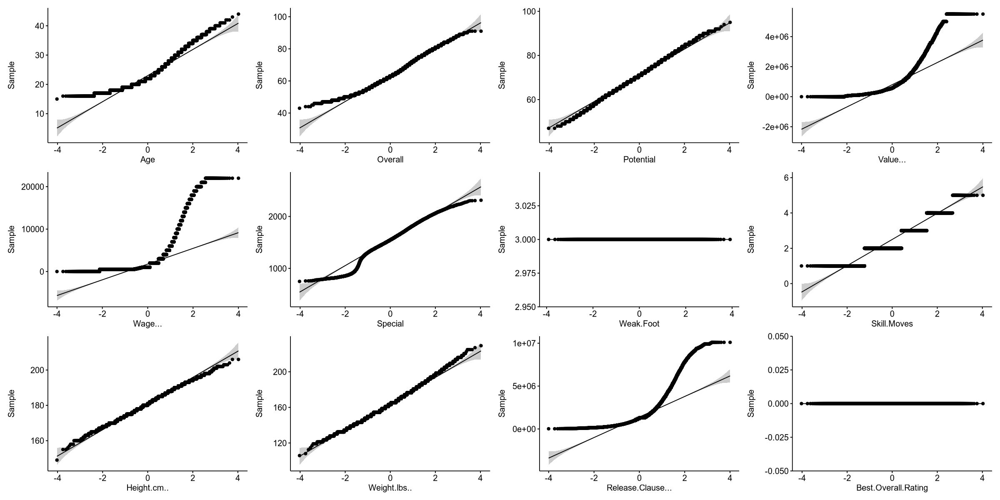

In [18]:
options(repr.plot.width=20, repr.plot.height=10)
wrap_plots(qqplots, ncol=4)

De lo anterior deducimos:
- Como se ha mencionado en el apartado anterior, a excepción de las variables discretas y aquellas referentes al precio, las demás parecen asemejarse a dsitribuciones normales.

- Fuera de lo mencionado anteriormente, los únicos comportamientos raros se observan en las variables:
    - `Age` : pues su cola izquierda se desvía de manera apreciable de la tendencia esperada por una normal. Esto podría mostrar la alta concentración de jugadores muy jóvenes.
    
    - `Special` : Análogamente al caso anterior, aunque de manera menos pronunciada, esta variable presenta una ligera desviación de la tendencia normal, como si existiera una pequeña distribución bimodal, con una de las modas en dicha región, lo que se puede apreciar también en los histogramas. Esto podría sugerir que existen 2 tipos de jugadores en cuanto a la calidad de sus movimientos especiales se refiere, teniendo una mayoría con una mayor calidad. 

#### Test de hipótesis

Para comprobar la posible normalidad de cada uno de los atributos lanzaremos para cada uno de ellos un test de Anderson-Darling (pues contamos con más de 5000 muestras):

In [92]:
options(repr.plot.width=6, repr.plot.height=5)

vars <- colnames(ds)[-(c(1:3,10, length(ds)))]
shapiro_tests <- lapply(
    X=vars, 
    FUN = \(varName){
        filtered_data <- ds[!vars_iqr_analysis[[varName]]$son.outliers.IQR.extremos, ] %>% pull(varName)
        ad.test(filtered_data)$p.value
        }
    )
names(shapiro_tests) <- vars
shapiro_tests

$Age
[1] 3.7e-24

$Overall
[1] 3.7e-24

$Potential
[1] 3.7e-24

$Value...
[1] 3.7e-24

$Wage...
[1] 3.7e-24

$Special
[1] 3.7e-24

$Skill.Moves
[1] 3.7e-24

$Height.cm..
[1] 3.7e-24

$Weight.lbs..
[1] 3.7e-24

$Release.Clause...
[1] 3.7e-24

Donde en la celda anterior he eliminado del cálculo las variables `Weak.Foot'` y `Best.Overall.Rating` porque la manera de distribuirse impide poder ejecutar el test sobre ellas.<br>

Apreciamos así que, aplicando el test de Anderson-Darling, no podemos descartar que las distribuciones univariables subyacenes a cada variable no sigan una distribución normal. 

### Detección de outliers mediante métodos estadísticos

Una vez confirmado que no podemos descartar la normaldad de las distribuciones subyacentes a cada variable, podemos comprobar si el punto más alejado de cada distribución normal se trata o no de un outliier, aplicando el **test de Grubbs** sobre dicha distribución:

En este caso, como al desarrollar el método IQR hemos visto que varias variables contaban con numerosos outliers, y el test de Grubbs solo clasifica la medida más alejada de la distribución normal como outlier o no outlier, lo que haremos será aplicar el test de manera recursiva, con un valor $\alpha$ máximo para cada medida, pero limitando el error máximo debido a aplicar el test de manera recursiva (el error FWER) a 0.05.
<br>
<br>
La idea con ello, será, pues, encontrar el valor de $\alpha$ que nos retorne el mayor número de outliers cumpliendo $ERROR_{FWER}<0.05$ :

#### Wage

Con la idea de compararlo con lo obtneido mediante el método IQR, comenzaremos aplicando el método estadístico sobre la variable `Wage`: 

In [68]:
var_name <- "Wage..."

In [21]:
grubbs_recursive_fwer <- function(x, alpha) {
    x_original <- x
    removed_idx <- c()
    iteration <- 0
    
    repeat {
        iteration <- iteration + 1
        
        # Grubbs test
        gt <- grubbs.test(x, two.sided = TRUE)
        pval <- gt$p.value
        
        # FWER: 1 - (1-alpha)^iteration
        fwer <- 1 - (1 - alpha)^iteration
        
        # Parar si deja de ser significativo o se supera FWER
        if (pval >= alpha || fwer >= 0.05) break
        
        # Identificar el outlier extremo
        outlier <- as.numeric(strsplit(gt$alternative, " ")[[1]][3])
        idx <- which(x == outlier)[1]
        
        # Guardar índice global
        global_idx <- which(x_original == outlier)[1]
        removed_idx <- c(removed_idx, global_idx)
        
        # Eliminar
        x <- x[-idx]
        
        # Parar si quedan < 3 valores
        if (length(x) < 3) break
    }
    
    return(list(clean = x,
                removed = removed_idx,
                n_outliers = length(removed_idx)))
}


In [69]:
for (alph in c(1e-1, 1e-2, 1e-3, 1.5e-4, 1.45e-4, 1.2e-4, 1.1e-4, 1e-4, 9.9e-5, 1e-5, 1e-6)){
    cat(alph,
        length(
            grubbs_recursive_fwer(
            x = ds %>% pull(var_name),
            alpha = alph
            )$removed
            ),
        "\n") 
}


0.1 0 
0.01 5 
0.001 51 
0.00015 341 
0.000145 346 
0.00012 337 
0.00011 337 
1e-04 325 
9.9e-05 325 
1e-05 213 
1e-06 184 


Con lo que parece que el mayor número de outliers se obtienen estadísticamente fijando un valor $\alpha \approx 0.000145$.

<br>

Ejecutemos nuevamente el test con ese valor y comprobemos las muestras clasificadas como outliers, comparadas estas con las obtenidas mediante el método IQR. 
<br>
Para comparar ambos buscaremos el límite superior e inferior que el alogitmo nos da para obtener los outliers:

In [22]:
n_outliers_outlier <- function(x, n) {
    x <- as.numeric(x)
    removed <- c()

    for (i in 1:n) {
        if (length(x) < 1) break

        val <- outlier(x)            # valor más extremo
        removed <- c(removed, val)
        
        # elimino SOLO la primera aparición
        idx <- which(x == val)[1]
        x <- x[-idx]
    }
    
    return(list(
        removed_values = removed,
        clean = x
    ))
}


In [41]:
x = ds %>% pull(var_name)

(n_outliers <- length(grubbs_recursive_fwer(
            x = x,
            alpha = 1.45e-4
            )$removed))

x_no <- n_outliers_outlier(x, n_outliers)$clean #x_NoOutliers
lim_inf <- min(x_no)
lim_sup <- max(x_no)

is_grubbs_outlier <- (x<lim_inf)|(x>lim_sup)

[1] 346

In [75]:
cat("Comparación IQR-Grubbs para", var_name, ":")

data.frame(
    IQR = c(
            n_outliers=sum(vars_iqr_analysis[[var_name]]$son.outliers.IQR), 
            lim_inf=vars_iqr_analysis[[var_name]]$extremo.inferior.IQR, 
            lim_sup=vars_iqr_analysis[[var_name]]$extremo.superior.IQR
            ),
    Grubbs = c(
            n_outliers=n_outliers, 
            lim_inf=lim_inf, 
            lim_sup=lim_sup
            )
)

Comparación IQR-Grubbs para Potential :

,IQR,Grubbs
,<dbl>,<dbl>
n_outliers,224,353
lim_inf,55,46
lim_sup,87,81


Con lo que observamos que el test de Grubbs no se arriesga tanto y clasifica mucho menos puntos (que el método IQR) como outiers. Sin embargo, al trabajar directamente sobre cada una de las meidas de la distribución, establece límites con sentido, lo que se observa en este caso al comparar los límites inferiores otorgados por ambos métodos.
<br>
En ambos casos todos los puntos calificados como outliers lo serán tratándose de outliers superiores, en vista de los límites impuestos por cada método. Con ello, todos los puntos calificados como outliers por el test de Grubbs serán clasificados como tal también por el método IQR, pero no del revés. 

#### Potential

Con la idea de compararlo con lo obtenido mediante el método IQR, comenzaremos aplicando el método estadístico sobre la variable `Wage`: 

In [76]:
var_name <- "Potential"

In [77]:
for (alph in c(1e-1, 1e-2, 1e-3, 1e-4, 1e-5, 1e-6)){
    cat(alph,
        length(
            grubbs_recursive_fwer(
            x = ds %>% pull(var_name),
            alpha = alph
            )$removed
            ),
        "\n") 
}


0.1 0 
0.01 0 
0.001 0 
1e-04 0 
1e-05 0 
1e-06 0 


Con lo que parece que el test de Grubbs no calificaría ningún punto como outlier para esta variable, lo que, recordando su dsitribución, puede parecer comprensible:

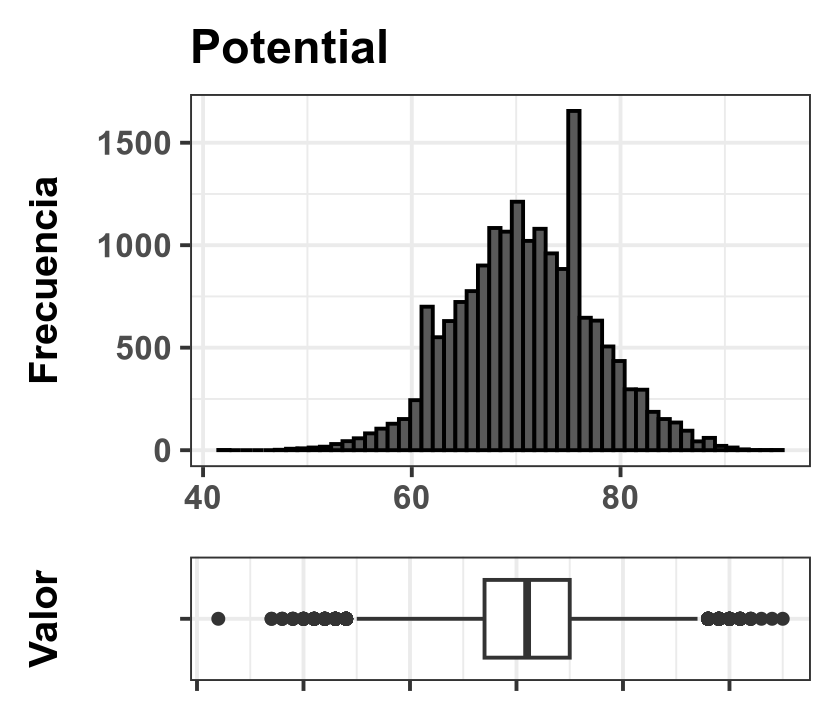

In [83]:
indiv_hist_boxplot(ds, var_name)

Pues, como se observa, no tiene una forma muy rara, lo que hará que el test rechaze.
<br>
<br>
Comparemos, aún así, sus resultados con los obtenidos mendiante el método IQR:

In [81]:
x = ds %>% pull(var_name)

(n_outliers <- length(grubbs_recursive_fwer(
            x = x,
            alpha = 0.01
            )$removed))

x_no <- n_outliers_outlier(x, n_outliers)$clean #x_NoOutliers
lim_inf <- min(x_no)
lim_sup <- max(x_no)

is_grubbs_outlier <- (x<lim_inf)|(x>lim_sup)

[1] 0

In [84]:
cat("Comparación IQR-Grubbs para", var_name, ":")

data.frame(
    IQR = c(
            n_outliers=sum(vars_iqr_analysis[[var_name]]$son.outliers.IQR), 
            lim_inf=vars_iqr_analysis[[var_name]]$extremo.inferior.IQR, 
            lim_sup=vars_iqr_analysis[[var_name]]$extremo.superior.IQR
            ),
    Grubbs = c(
            n_outliers=n_outliers, 
            lim_inf=lim_inf, 
            lim_sup=lim_sup
            )
)

Comparación IQR-Grubbs para Potential :

,IQR,Grubbs
,<dbl>,<dbl>
n_outliers,224,0
lim_inf,55,47
lim_sup,87,94


Observamos, pues, que:
- En realidad, el método IQR no clasificó tantos puntos como outliers (en comparación al número total de puntos de la muestra, o los clasificados como outliers para variables como `Wage...`), con lo que cabría esperar que el test de Grubbs, que cabría esperar que fuera más exigente, clasificara muy pocos como outliers (en este caso, ninguno).
- Los límites para outliers impuestos por ambos métodos son bastante similares.

## **Métodos multivariantes**

A continuación comprobaremos la posible existencia de outliers en varias dimensiones, lo que nos dará la oportunidad de encontrar no solo muestras con valores extremos en determinadas varriables, sino también con valores normales de estas, pero combinados de manera anómala.

### **Métodos basados en la distancia de Mahalanobis**

De manera análoga al apartado anterior, estos requieren que la distribución subyacente sea normal multivariante. Para ello comprobaremos mediantes métodos gráficos y estadísticos si la distancia de Mahalanobis de la distribución sigue una dsitribución tipo $\chi^2$, tal y como cabría esperar.
<br>
<br>
Para el análisis que sigue tomaré las siguientes variables: 'Age''Overall''Potential''Value...''Wage...''Special''Height.cm..''Weight.lbs..''Release.Clause...'

In [97]:
colnames(ds)

[1] "Name"                "Position"            "Preferred.Foot"     
 [4] "Age"                 "Overall"             "Potential"          
 [7] "Value..."            "Wage..."             "Special"            
[10] "Weak.Foot"           "Skill.Moves"         "Height.cm.."        
[13] "Weight.lbs.."        "Release.Clause..."   "Best.Overall.Rating"

In [ ]:
cols_maha <- c(-(1:3),-10,-11,-15, -9, -8,-7,-14)
cat(
    "Columns to apply Mahalanobis method: \n",
    paste(colnames(ds)[cols_maha], collapse = ", "),
    sep=""
)

Columns to apply Mahalanobis method: 
Age, Overall, Potential, Height.cm.., Weight.lbs..

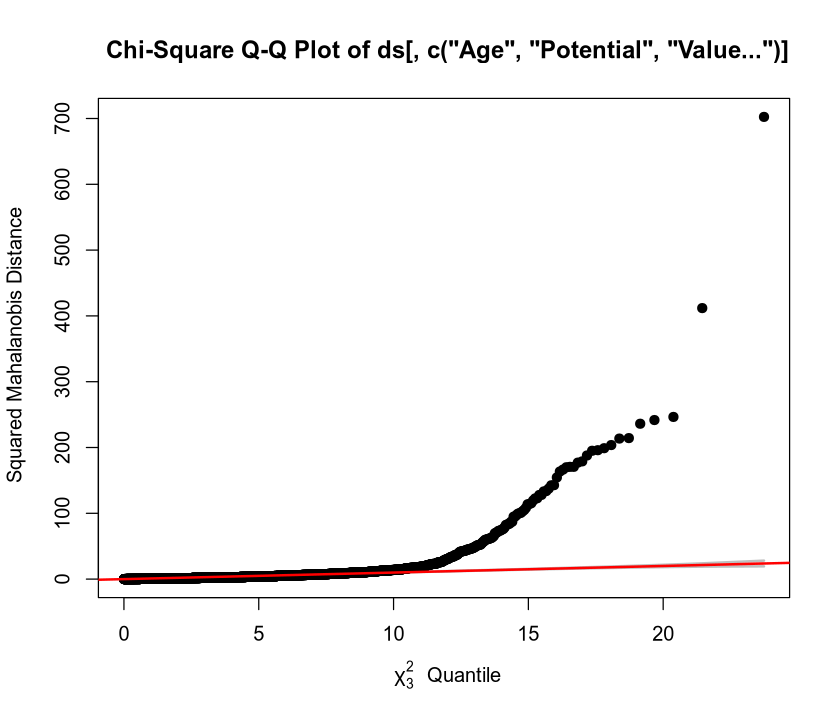

In [ ]:
cqplot(ds[!vars_iqr_analysis$Value...$son.outliers.IQHeight.cm.."R,c("Age", "Potential", "Height.cm..")], method="classical")



- **QQ-plot**

### **Representación mediante Bi-Plots**

Con el objetivo de reducir la dimensionalidad de nuestro  conjunto de datos para poder visualizar todas las muestras en una sola gráfica (en vez de en varias por pares) podemos desarrollar un pca y observar cómo se distribuyen las nubes de puntos:

In [50]:
library(plotly)

pca_3d <- function(data, clusters = NULL, scale_data = TRUE,
                   width = 1000, height = 800) {
  
  # PCA (solo admite columnas numéricas)
  pca <- prcomp(data, scale. = scale_data)
  
  # Varianza explicada (%)
  var_exp <- round(100 * summary(pca)$importance[2, 1:3], 2)
  
  # Coordenadas de observaciones
  pcs <- as.data.frame(pca$x[, 1:3])
  colnames(pcs) <- c("PC1", "PC2", "PC3")
  
  # Clusters opcionales
  if (!is.null(clusters)) pcs$cluster <- factor(clusters)
  
  # Loadings (direcciones)
  loadings <- as.data.frame(pca$rotation[, 1:3])
  colnames(loadings) <- c("PC1", "PC2", "PC3")
  loadings$varname <- rownames(loadings)
  
  # Escalado visual de los vectores
  scale_factor <- max(abs(pcs)) * 0.8
  loadings[, 1:3] <- loadings[, 1:3] * scale_factor
  
  # --- Gráfico según si hay clusters ---
  if (!is.null(clusters)) {
    fig <- plot_ly(
      pcs,
      x = ~PC1, y = ~PC2, z = ~PC3,
      type = "scatter3d",
      mode = "markers",
      color = ~cluster,
      colors = "Set1",
      marker = list(size = 2, opacity = 0.8)
    )
  } else {
    fig <- plot_ly(
      pcs,
      x = ~PC1, y = ~PC2, z = ~PC3,
      type = "scatter3d",
      mode = "markers",
      marker = list(size = 2, opacity = 0.8)
    )
  }
  
  # --- Añadir vectores de las variables ---
  for (i in 1:nrow(loadings)) {
    fig <- fig %>% add_trace(
      x = c(0, loadings$PC1[i]),
      y = c(0, loadings$PC2[i]),
      z = c(0, loadings$PC3[i]),
      type = "scatter3d",
      mode = "lines+text",
      text = loadings$varname[i],
      textposition = "top center",
      line = list(width = 6),
      showlegend = FALSE
    )
  }
  
  # --- Layout con width y height personalizables ---
  fig <- fig %>%
    layout(
      title = "PCA en 3 dimensiones",
      width = width,
      height = height,
      scene = list(
        xaxis = list(title = paste0("PC1 (", var_exp[1], "%)")),
        yaxis = list(title = paste0("PC2 (", var_exp[2], "%)")),
        zaxis = list(title = paste0("PC3 (", var_exp[3], "%)"))
      )
    )
  
  return(fig)
}


In [51]:
options(repr.plot.height=15)
pca_3d(ds[-(1:3)])

Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”
A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A marker object has been specified, but markers is not in the mode
Adding markers to the mode...

A 

HTML widgets cannot be represented in plain text (need html)

Primero debemos resaltar el hecho de que la variabilidad en las 11 dimensiones parece poder explicarse al proximadamente 72.5% con solo las 3 primeras componentes principales, lo que, pese a no ser idóneo, es una aproximación bastante buena para analizar las distribuciones y tendencias.
<br>
<br>
Una vez dicho eso, ¿qué observamos?
<br>
La distribución parece tener la forma de una pierna con un zapato cuya suela apunta en la diagonal descendente del plano PC1-PC3, donde la mayoría de puntos se localizan en una región con métricas financieras bastante bajas (zona de la bota/pie), de manera que conforme nos alejamos de dicha nube (a lo largo de toda la pierna) tenemos cada vez muchas menos muestras con unas métricas financieras tan altas. A destacar encontramos también:

- La alta correlación mostrada entre `Release.Clause...` y `Value...`, que prácticamente apuntan en la misma dirección. La variable `Wage` se aleja un poco de las anteriores, aunque no tanto. Este paralelismo era de eperar, pues jugadores vendidos a altos precios anteriormente serán vendidos a altos precios también posteriormente.

- La considerable correlación entre `Height.cm..` y `Weight-lbs..`, tal y como cabría esperar, pues a mayor altura suele corresponderse un mayor peso.

### **Método LOF**

Abreviación de LocalOutlierFactor, este método no requiere de que las distribuciones subyacentes sean normales, sino que se vale de las densidades y/o distancias relativas entre vecinos más cercanos; lo que en nuestro caso, considerando la desigualdad presente en las variables relacionadas al precio, supone un método más idóneo que los anteriores (basados en distribuciones normales multivariantes).
<br>
<br>
A la hora de aplicar el método LOF tomaré un valor de 20 vecinos más cercanos, lo que representa algo más de un 0.1% de la muestra completa:

In [58]:
lof_scores <- LOF(
    data = std_ds[, vars_to_analyze_iqr],
    k = 20)

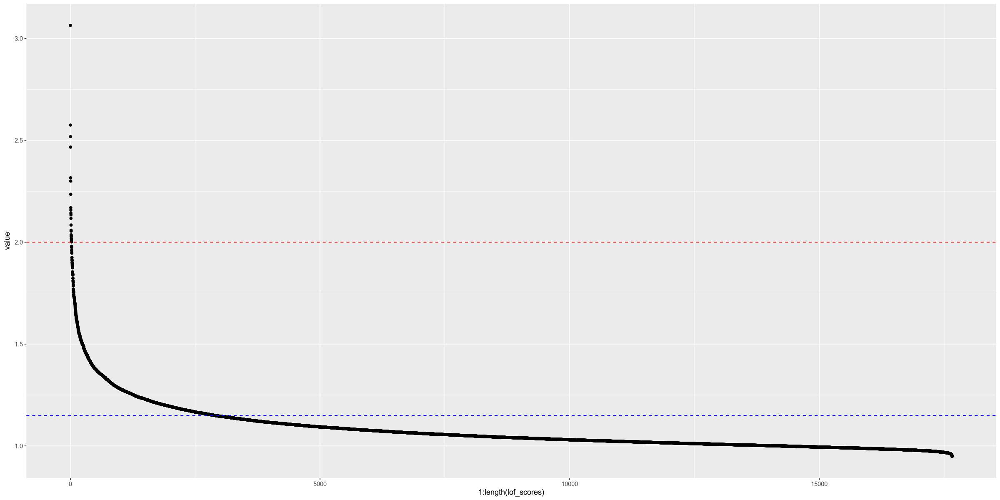

In [57]:
options(repr.plot.width = 20, repr.plot.height = 10)
lof_scores %>% sort(decreasing = TRUE) %>%
  as.data.frame() %>% dplyr::rename(value=".") %>%
  ggplot(aes(y=value, x = 1:length(lof_scores))) +
  geom_point() + 
  geom_hline(yintercept = 2.0, color="red", lty=2)+ 
  geom_hline(yintercept = 1.15, color="blue", lty=2)

Con lo que observamos que la mayoría de valores tienen una puntuación LOF por debajo de 1.15.
<br>
<br>
En este análisis cribaremos los datos como outliers a partir de un lof_score mayor a 2.0, a partir del que los valores se disparan.

<br>

Guardemos, pues, las muestras con $lof_{score}>2.0$: 

In [59]:
is.lof.outlier <- lof_scores>=2.0
cat(sum(is.lof.outlier))

22

Criterio con el que encontramos un total de 22 outliers. Gráficamente:

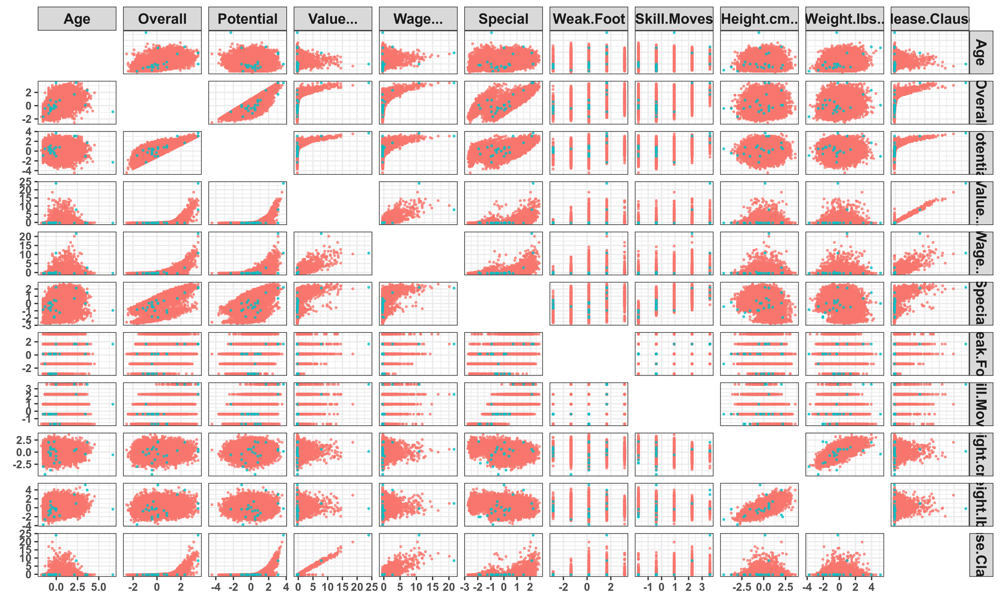

In [61]:
options(repr.plot.width=25, repr.plot.height=15)

std_ds %>% mutate(isLOFo = is.lof.outlier) %>% arrange(isLOFo) %>%
  dplyr::select(isLOFo, 4:last_col()) %>%
  ggpairs(
    columns = 2:ncol(.),                # solo variables numéricas desde la 4ª a la última
    aes(color = isLOFo),
    upper = list(continuous = wrap("points", alpha = 0.7, size=1)),
    lower = list(continuous = wrap("points", alpha = 0.7, size=1)),
    diag = list(continuous = "blankDiag")  # elimina histogramas
  ) + tema_custom

Este método nos muestra la presencia de muestras que se alejan de las nubes de puntos, sin requerir de que estas sean valores extremos así como tampoco la normalidad mutivariante de las variables.

##### Búsqueda promesa futbolística

Nuevamente, tratemos de buscar jugadores promesa inponiendo las siguientes condiciones:
- La muestra debe ser calificada como un outlier por el método LOF.
- La muestra debe tener un potencial y un overall mayor a la media.
- Todas las variables referentes al precio deben estar por debajo de la media. 

In [114]:
(promesas <- std_ds[is.lof.outlier,] %>% filter(Value...<0, Release.Clause...<0, Potential>0, Overall>0))
ds %>% filter(Name %in% promesas$Name) %>% arrange(desc(Potential), Release.Clause...)


Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...
<fct>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Z. Ibrahimović,RES,Right,3.6364022,2.31829085,1.6874543,-0.34940595,2.6767059,1.50085148,1.6573056,3.583402,2.0260821,3.9631773,-0.2528551
11 Ronaldo,RES,Right,2.1277232,1.69611154,3.0657432,-0.34940595,-0.3999567,0.70335257,1.6573056,3.583402,0.3025598,2.9607056,-0.2528551
N. Zortea,RES,Right,-0.0275326,0.57618878,0.7685951,-0.01782725,0.2349102,0.38505257,-2.8640153,-0.393985,-0.8464550,-0.6195505,-0.0139740
E. Emegha,SUB,Right,-0.8896349,0.07844533,0.7685951,-0.17086357,-0.2534490,0.04576575,0.1501987,-0.393985,2.0260821,-1.6220223,-0.1798637
09 Fábio Paim,RES,Right,-0.6741093,0.82506050,1.0748815,-0.34940595,-0.3999567,-0.94061448,0.1501987,-1.719781,-0.7028282,-1.1923915,-0.2528551
07 P. Ikedia,RES,Right,0.4035186,0.82506050,0.7685951,-0.34940595,-0.3999567,-1.26241228,0.1501987,-1.719781,-2.1390968,-1.7652325,-0.2528551
22 A. Stergiakis,RES,Right,-0.2430582,0.07844533,0.4623087,-0.20912265,-0.1069413,-1.92349690,0.1501987,-1.719781,2.1697090,-2.0516530,-0.1864992


Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...
<fct>,<fct>,<fct>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
11 Ronaldo,RES,Right,33,77,91,0,0,1739,4,5,183,209.475,1300000
Z. Ibrahimović,RES,Right,40,82,82,0,63000,1967,4,5,195,224.910,1300000
09 Fábio Paim,RES,Right,20,70,78,0,0,1269,3,1,176,145.530,1300000
07 P. Ikedia,RES,Right,25,70,76,0,0,1177,3,1,166,136.710,1300000
E. Emegha,SUB,Right,19,64,76,1400000,3000,1551,3,2,195,138.915,2400000
N. Zortea,RES,Right,23,68,76,2600000,13000,1648,1,2,175,154.350,4900000
22 A. Stergiakis,RES,Right,22,64,74,1100000,6000,988,3,1,196,132.300,2300000


In [82]:
(df <- read.csv("data/CLEAN_FIFA23_official_data.csv")) %>% filter(Name %in% promesas$Name) %>% dplyr::select(1:6)

X,ID,Name,Age,Photo,Nationality
<int>,<int>,<chr>,<int>,<chr>,<chr>
997,41236,Z. Ibrahimović,40,https://cdn.sofifa.net/players/041/236/23_60.png,Sweden
4191,37576,11 Ronaldo,33,https://cdn.sofifa.net/players/037/576/11_60.png,Brazil
6145,252440,N. Zortea,23,https://cdn.sofifa.net/players/252/440/23_60.png,Italy
8735,258437,E. Emegha,19,https://cdn.sofifa.net/players/258/437/23_60.png,Netherlands
15258,183375,09 Fábio Paim,20,https://cdn.sofifa.net/players/183/375/09_60.png,Portugal
15932,2143,07 P. Ikedia,25,https://cdn.sofifa.net/players/002/143/07_60.png,Nigeria
16470,259206,22 A. Stergiakis,22,https://cdn.sofifa.net/players/259/206/22_60.png,Greece


Desde mi criterio, los jugadores más interesanes serían, así:
 - **11 Ronaldo** (que no Cristiano Ronaldo), jugador del equipo nacional de Brasil, pues:
    - tiene un `Potential` muy alto (igual a 91, por encima del percentil 99.9%)

    - tiene un `Overall` muy alto (igual a 82, por encima del percentil 98.5%)

    - su `Release.Clause...` es la menor de los outliers encontrados, con un valor igual a la mediana.

    - cuenta con una habilidad notable con su pie débil y un número muy alto de movimientos especiales
<br>

 - **Z. Ibrahimović**, jugador del equipo nacional de Suecia, pues, en resumidas cuentas, presenta el mismo beneficio que el jugador anterior respecto a la variable `Release.Clause...`, así como respecto a sus movimientos especiales y habilidad con su pie débil; pero con un mayor equilibrio `Potential`-`Overall`, igual a 82 en ambos casos (lo que sigue estando por encima del percentil 95% respecto de ambas variables, destancando con ello en las mismas).

No obstante, cabe tener en cuenta que ambos jugadores cuentan con una edad considerable (33 y 40, respectivamente) respecto de los estándares del deporte, sobre todo en el segundo caso, lo que podría condicionar la toma de decisiones a la hora de un futuro contrato.


Antes de continuar, comprobemos sus posiciones en el espacio de coordenadas para inferir la razón por la que han sido clasificados como outliers por el método LOF:

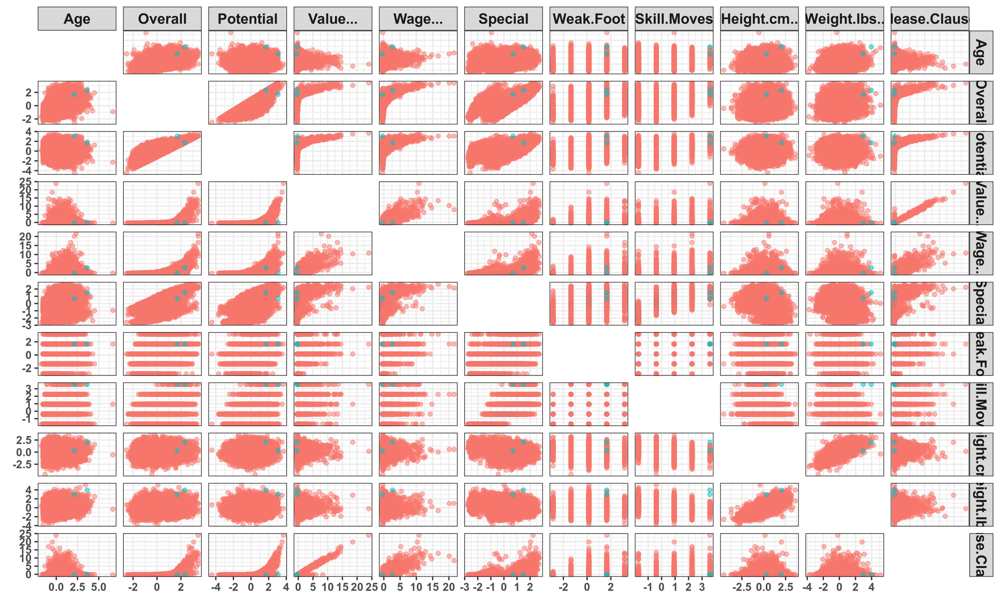

In [122]:
options(repr.plot.width=25, repr.plot.height=15)

std_ds %>% 
  mutate(isPromesa = std_ds$Name %in% promesas$Name[1:2]) %>% 
  arrange(isPromesa) %>%
  dplyr::select(isPromesa, 4:last_col()) %>%
  ggpairs(
    columns = 2:ncol(.),                # solo variables numéricas desde la 4ª a la última
    aes(color = isPromesa),
    upper = list(continuous = wrap("points", alpha = 0.5, size=3)),
    lower = list(continuous = wrap("points", alpha = 0.5, size=3)),
    diag = list(continuous = "blankDiag")  # elimina histogramas
  ) + tema_custom

No obstante, las muestras mencionadas anteriormente no dejan de ser outliers por su valor extremo en variables dadas, por lo que podríamos haberlos obtenido también mediante el método IQR.

Sin embargo, este método nos muestra también otros jugadores con caracter anómalo pese a tener características no muy extremas, como lo es Fabio Paim o, posiblemente E.Emegha, los cuales, en vista de sus atributos estandarizados, no parecen presentar valores muy extremos. Se tratarían así de jugadores con un nivel medio-alto en la mayoría de métricas futbolísticas, que podrían no ir a la par con sus métricas financieras.

Si analizamos los puntos caracterizados como outliers según este método:

In [117]:
library(plotly)

pca_3d <- function(data, op1=0.5, op2=1, labels = NULL, clusters = NULL, scale_data = TRUE,
                   width = 1000, height = 800) {
  
  # 1. Solo columnas numéricas
  data_num <- data[, sapply(data, is.numeric), drop = FALSE]
  
  # 2. PCA
  pca <- prcomp(data_num, scale. = scale_data)
  
  # 3 PCs
  pcs <- as.data.frame(pca$x[, 1:3])
  colnames(pcs) <- c("PC1", "PC2", "PC3")
  
  # Añadir labels
  if (!is.null(labels)) {
    if (length(labels) != nrow(pcs))
      stop("labels debe tener la misma longitud que las filas del dataset.")
    pcs$label <- labels
  } else {
    pcs$label <- ""
  }
  
  # Varianza explicada
  var_exp <- round(100 * summary(pca)$importance[2, 1:3], 2)
  
  # Clusters
  if (!is.null(clusters)) {
    if (length(clusters) != nrow(pcs))
      stop("clusters debe tener misma longitud que las filas del dataset.")
    pcs$cluster <- factor(clusters)
  }
  
  # Loadings (direcciones)
  loadings <- as.data.frame(pca$rotation[, 1:3])
  loadings$varname <- rownames(loadings)
  
  scale_factor <- max(abs(as.matrix(pcs[,1:3]))) * 0.8
  loadings[,1:3] <- loadings[,1:3] * scale_factor
  
  
  # --- FIGURA DE PUNTOS ---
  if (!is.null(clusters)) {
    
    pcs$cluster_bin <- as.logical(pcs$cluster %in% c("TRUE", "1", "T"))
    
    # Trace 1: cluster TRUE (con texto permanente)
    fig <- plot_ly(
      data = pcs[pcs$cluster_bin == TRUE, ],
      x = ~PC1, y = ~PC2, z = ~PC3,
      type = "scatter3d",
      mode = "markers+text",    # ← muestra el label permanentemente
      text = ~label,            # ← nombre visible
      textposition = "top center",
      hoverinfo = "text",
      color = I("red"),
      marker = list(size = 4, opacity = op2),
      name = "Cluster TRUE",
      width = width,
      height = height
    )
    
    # Trace 2: cluster FALSE (sin texto, opacidad baja)
    fig <- fig %>% add_trace(
      data = pcs[pcs$cluster_bin == FALSE, ],
      x = ~PC1, y = ~PC2, z = ~PC3,
      type = "scatter3d",
      mode = "markers",
      text = "",                 # ← NO muestra texto
      hoverinfo = "none",
      color = I("blue"),
      marker = list(size = 4, opacity = op1),
      name = "Cluster FALSE"
    )
    
  } else {
    
    # Caso sin clusters: solo texto en hover
    fig <- plot_ly(
      data = pcs,
      x = ~PC1, y = ~PC2, z = ~PC3,
      type = "scatter3d",
      mode = "markers+text",
      text = ~label,
      textposition = "top center",
      hoverinfo = "text",
      marker = list(size = 3, opacity = 0.5),
      width = width,
      height = height
    )
  }
  
  
  # --- AÑADIR FLECHAS (loadings) ---
  for (i in 1:nrow(loadings)) {
    fig <- fig %>% add_trace(
      x = c(0, loadings$PC1[i]),
      y = c(0, loadings$PC2[i]),
      z = c(0, loadings$PC3[i]),
      type = "scatter3d",
      mode = "lines+text",
      text = loadings$varname[i],
      textposition = "top center",
      line = list(width = 6),
      showlegend = FALSE,
      inherit = FALSE
    )
  }
  
  
  # --- LAYOUT ---
  fig <- fig %>% layout(
    title = "PCA en 3 dimensiones",
    scene = list(
      xaxis = list(title = paste0("PC1 (", var_exp[1], "%)")),
      yaxis = list(title = paste0("PC2 (", var_exp[2], "%)")),
      zaxis = list(title = paste0("PC3 (", var_exp[3], "%)"))
    )
  )
  
  return(fig)
}


In [118]:
pca_3d(ds[-(1:3)], clusters=is.lof.outlier, labels=ds$Name, op1=0.01, op2=1)

HTML widgets cannot be represented in plain text (need html)

Con lo que observamos que el método LOF detectó outliers:
- Fuera de la nube de puntos, por sus valores extremos:
    - K. Mbappé en la dirección de `Release.Clause...` y `Value...`.
    - Z. Ibrahimovic en la dirección de `Overall` y `Age`.
    - 11 Ronaldo y K. Miura, con costos muy bajos pero `Overall` destacable...

- Dentro, de la nube de puntos, localizados en la regiones de bajo `Release.Clause...` y `Value...`, con las combinaciones no extremas, como lo son 08 G.Fofana y A.Ojeda.

In [114]:
std_ds[is.lof.outlier,] %>% arrange(Release.Clause...)

Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...
<fct>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
21 F. Seidel,RES,Right,-1.5362116,-1.66365675,-0.915980239,-0.33537762,-0.3755388,-0.84267601,0.1501987,-0.3939850,-3.0008579,-3.77017591,-0.3239886
22 A. Akinfenwa,SUB,Right,3.4208766,0.07844533,-1.069123449,-0.32389990,-0.3022849,0.01078773,0.1501987,-0.3939850,-0.4155745,5.10885921,-0.3158932
D. Dassy,RES,Left,-0.8896349,-1.16591330,0.156022233,-0.31433513,-0.3511208,-0.65379469,-2.8640153,-0.3939850,0.0153061,-0.76276079,-0.3003659
Y. Kalley,RES,Left,-0.4585837,-0.41929812,0.002879023,-0.28245256,-0.3511208,-0.20607601,-2.8640153,-0.3939850,0.5898135,0.09650067,-0.2816535
21 G. Rodríguez,RCB,Right,-0.6741093,-0.79260571,-0.303407398,-0.30158210,-0.3755388,-0.54536282,-2.8640153,-0.3939850,0.5898135,0.52613141,-0.2806582
P. Trujillo,SUB,Right,-0.2430582,-0.41929812,-0.609693818,-0.29520559,-0.3755388,-1.80457162,0.1501987,-1.7197805,-2.2827236,-2.05165299,-0.2728282
D. Camara,RES,Right,-0.6741093,-0.66816985,0.462308654,-0.28245256,-0.3682134,0.03527234,-2.8640153,-0.3939850,-0.2719476,-0.61955055,-0.2594907
22 A. Ojeda,RES,Right,-1.3206861,-0.41929812,0.462308654,-0.27926430,-0.3682134,-0.42643755,-1.3569083,-0.3939850,-4.5807533,-2.62449396,-0.2594907
Z. Ibrahimović,RES,Right,3.6364022,2.31829085,1.687454337,-0.34940595,2.6767059,1.50085148,1.6573056,3.5834017,2.0260821,3.96317726,-0.2528551


### **Método LOF** (pruebas con diferentes numeros de vecinos)

Abreviación de LocalOutlierFactor, este método no requiere de que las distribuciones subyacentes sean normales, sino que se vale de las densidades y/o distancias relativas entre vecinos más cercanos; lo que en nuestro caso, considerando la desigualdad presente en las variables relacionadas al precio, supone un método más idóneo que los anteriores (basados en distribuciones normales multivariantes).
<br>
<br>
A la hora de aplicar el método LOF tomaré un valor de 20 vecinos más cercanos, lo que representa algo más de un 0.1% de la muestra completa:

In [23]:
lof_scores <- LOF(
    data = std_ds[, vars_to_analyze_iqr],
    k = 5)

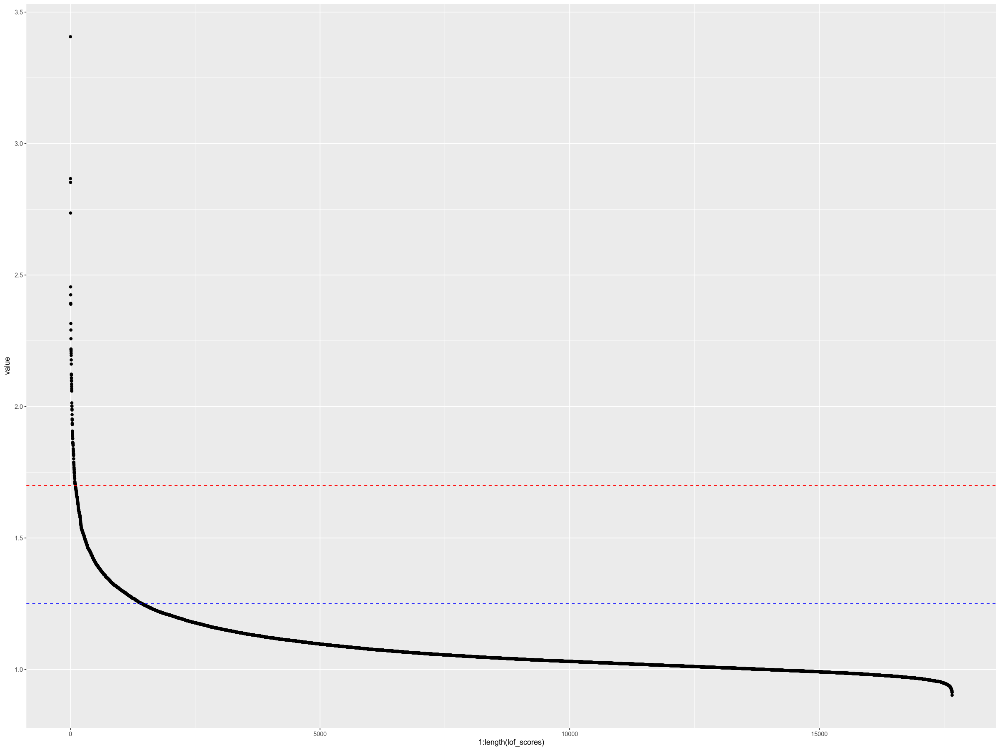

In [25]:
options(repr.plot.width = 20)
lof_scores %>% sort(decreasing = TRUE) %>%
  as.data.frame() %>% dplyr::rename(value=".") %>%
  ggplot(aes(y=value, x = 1:length(lof_scores))) +
  geom_point() + 
  geom_hline(yintercept = 1.7, color="red", lty=2)+ 
  geom_hline(yintercept = 1.25, color="blue", lty=2)

Con lo que observamos que la mayoría de valores tienen una puntuación LOF por debajo de 1.25.
<br>
<br>
En este análisis cribaremos los datos como outliers a partir de un lof_score mayor a 1.7, a partir del que los valores se disparan.

<br>

Guardemos, pues, las muestras con $lof_{score}>1.7$: 

In [26]:
is.lof.outlier <- lof_scores>=1.7
cat(sum(is.lof.outlier))

101

In [27]:
options(repr.plot.width=25, repr.plot.height=15)

std_ds %>% mutate(isLOFo = is.lof.outlier) %>% arrange(isLOFo) %>%
  dplyr::select(isLOFo, 4:last_col()) %>%
  ggpairs(
    columns = 2:ncol(.),                # solo variables numéricas desde la 4ª a la última
    aes(color = isLOFo),
    upper = list(continuous = wrap("points", alpha = 0.7, size=1)),
    lower = list(continuous = wrap("points", alpha = 0.7, size=1)),
    diag = list(continuous = "blankDiag")  # elimina histogramas
  ) + tema_custom

Este método nos muestra la presencia de muestras que se alejan de las nubes de puntos, sin requerir de que estas sean valores extremos así como tampoco la normalidad mutivariante de las variables.

##### Búsqueda promesa futbolística

Nuevamente, tratemos de buscar jugadores promesa inponiendo las siguientes condiciones:
- La muestra debe ser calificada como un outlier por el método LOF.
- La muestra debe tener un potencial y un overall mayor a la media.
- Todas las variables referentes al precio deben estar por debajo de la media. 

In [28]:
(promesas <- std_ds[is.lof.outlier,] %>% filter(Value...<0, Release.Clause...<0, Potential>0, Overall>0))
ds %>% filter(Name %in% promesas$Name) %>% arrange(desc(Potential))


Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...
<fct>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Y. Yotún,LCM,Left,1.9121976,1.07393223,0.156022233,-0.119851466,-0.3633298,1.72820862,-2.8640153,0.9318106,-1.2773356,-0.76276079,-0.08032986
16 Éverton Ribeiro,SUB,Left,0.6190441,2.19385499,1.840597547,-0.349405951,-0.3999567,1.63376796,0.1501987,3.5834017,-0.9900819,-0.76276079,-0.25285510
Z. Ibrahimović,RES,Right,3.6364022,2.31829085,1.687454337,-0.349405951,2.6767059,1.50085148,1.6573056,3.5834017,2.0260821,3.96317726,-0.25285510
A. Vega,SUB,Right,0.1879930,1.69611154,1.840597547,-0.349405951,-0.3999567,1.42040203,0.1501987,0.9318106,-1.1337088,0.38292116,-0.25285510
22 A. Dzyuba,SUB,Right,1.9121976,1.82054740,1.074881495,-0.349405951,-0.3999567,1.10909763,0.1501987,0.9318106,2.1697090,2.38786458,-0.25285510
C. Montes,RCB,Right,0.4035186,1.69611154,1.687454337,-0.349405951,-0.3999567,0.99017235,0.1501987,-0.3939850,1.4515747,-0.61955055,-0.25285510
A. Diamanti,SUB,Left,3.4208766,1.19836809,0.309165444,-0.221875682,-0.2534490,0.96918554,-1.3569083,2.2576061,-0.1283208,0.09650067,-0.25285510
H. Barcos,LS,Right,3.2053510,0.94949636,0.002879023,-0.266511276,-0.3706552,0.94819873,3.1644126,0.9318106,0.8770672,2.38786458,-0.24621951
11 D. Moreira,RW,Right,1.9121976,0.82506050,1.074881495,-0.349405951,-0.3999567,0.86075367,0.1501987,0.9318106,-0.5592013,0.09650067,-0.25285510


Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...
<fct>,<fct>,<fct>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
16 Éverton Ribeiro,SUB,Left,26,81,83,0,0,2005,3,5,174,152.145,1300000
A. Vega,SUB,Right,24,77,83,0,0,1944,3,3,173,169.785,1300000
Z. Ibrahimović,RES,Right,40,82,82,0,63000,1967,4,5,195,224.910,1300000
C. Montes,RCB,Right,25,77,82,0,0,1821,3,2,191,154.350,1300000
10 J. Koller,SUB,Right,36,78,80,0,0,1580,3,1,202,233.730,1300000
C. Montes,SUB,Right,21,65,79,1800000,2000,1588,3,3,175,167.580,3600000
22 A. Dzyuba,SUB,Right,32,78,78,0,0,1855,3,3,196,200.655,1300000
11 D. Moreira,RW,Right,32,70,78,0,0,1784,3,3,177,165.375,1300000
09 Fábio Paim,RES,Right,20,70,78,0,0,1269,3,1,176,145.530,1300000


In [ ]:
(df <- read.csv("data/CLEAN_FIFA23_official_data.csv")) %>% filter(Name %in% promesas$Name)

X,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,⋯,Position,Joined,Loaned.From,Contract.Valid.Until,Height.cm..,Weight.lbs..,Release.Clause...,Kit.Number,Best.Overall.Rating,Year_Joined
<int>,<int>,<chr>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<chr>,⋯,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
4191,37576,11 Ronaldo,33,https://cdn.sofifa.net/players/037/576/11_60.png,Brazil,https://cdn.sofifa.net/flags/br.png,77,91,Sport Club Corinthians Paulista,⋯,RES,2009-01-01,None,2012,183,209.475,1300000,9,0,2009


### **Métodos basados en clustering**

Finalmente buscaremos los posibles outliers de la distribución mediante métodos basados en la distancia al centroide del cluster más cercano:

####  K-Means

Puesto que el número de clusters es algo arbitrario, aquí se escogerá de manera que se minimice la métrica silueta:

In [15]:
set.seed(0)

encontrar_k_optimo <- function(data, k_min = 2, k_max = 10, nstart = 10, graficar = TRUE) {
  
  # Guardamos los valores de silueta por cada k
  silhouette_scores <- numeric(k_max)
  
  for (k in k_min:k_max) {
    km <- kmeans(data, centers = k, nstart = nstart)
    sil <- silhouette(km$cluster, dist(data))
    silhouette_scores[k] <- mean(sil[, 3])
  }
  
  # Determinar el k óptimo
  k_optimo <- which.max(silhouette_scores)
  
  # Entrenar el modelo final
  modelo_final <- kmeans(data, centers = k_optimo, nstart = nstart)
  
  # Graficar si se desea
  if (graficar) {
    plot(k_min:k_max,
         silhouette_scores[k_min:k_max],
         type = "b",
         xlab = "Número de clusters (k)",
         ylab = "Silhouette promedio",
         main = "Selección óptima de k con Silhouette")
    abline(v = k_optimo, col = "red", lty = 2)
  }
  
  return(list(
    k_optimo = k_optimo,
    silhouette = silhouette_scores,
    modelo = modelo_final
  ))
}

In [16]:
colnames(ds)
c("Age", "Overall", "Potential", "Value...", "Wage...", "Reñease.Clause...")

[1] "Name"              "Position"          "Preferred.Foot"   
 [4] "Age"               "Overall"           "Potential"        
 [7] "Value..."          "Wage..."           "Special"          
[10] "Weak.Foot"         "Skill.Moves"       "Height.cm.."      
[13] "Weight.lbs.."      "Release.Clause..."

[1] "Age"               "Overall"           "Potential"        
[4] "Value..."          "Wage..."           "Reñease.Clause..."

Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 883000)”


$k_optimo
[1] 2

$silhouette
[1] 0.0000000 0.6529182 0.3815125 0.3485505 0.3324517

$modelo
K-means clustering with 2 clusters of sizes 16616, 1044

Cluster means:
          Age    Overall  Potential   Value...    Wage... Release.Clause...
1 -0.04898658 -0.1298964 -0.1117019 -0.1879771 -0.1774555        -0.1842199
2  0.77965610  2.0673929  1.7778147  2.9917894  2.8243293         2.9319911

Clustering vector:
    [1] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
   [37] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
   [73] 2 2 2 2 2 2 2 1 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
  [109] 2 2 2 1 2 2 2 2 2 2 2 2 2 2 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1
  [145] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
  [181] 2 2 2 2 2 2 2 2 2 2 2 1 2 2 1 2 2 2 2 1 2 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2
  [217] 2 2 1 2 1 2 2 2 1 2 1 2 1 2 2 1 2 1 2 1 1 2 1 1 2 2 2 2 2 2 1 2 2 2 2 2
  [253] 2 2 2 2 2 2 2 2 1 2 

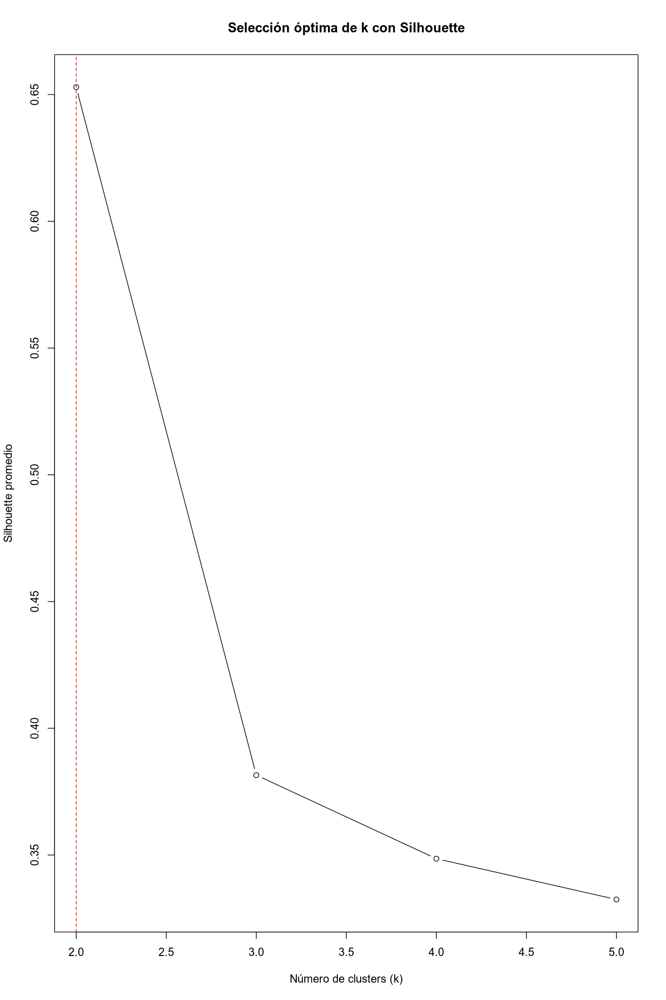

In [119]:
(res_kmeans <- encontrar_k_optimo(std_ds[c("Age", "Overall", "Potential", "Value...", "Wage...", "Release.Clause...")], k_min = 2, k_max = 5))

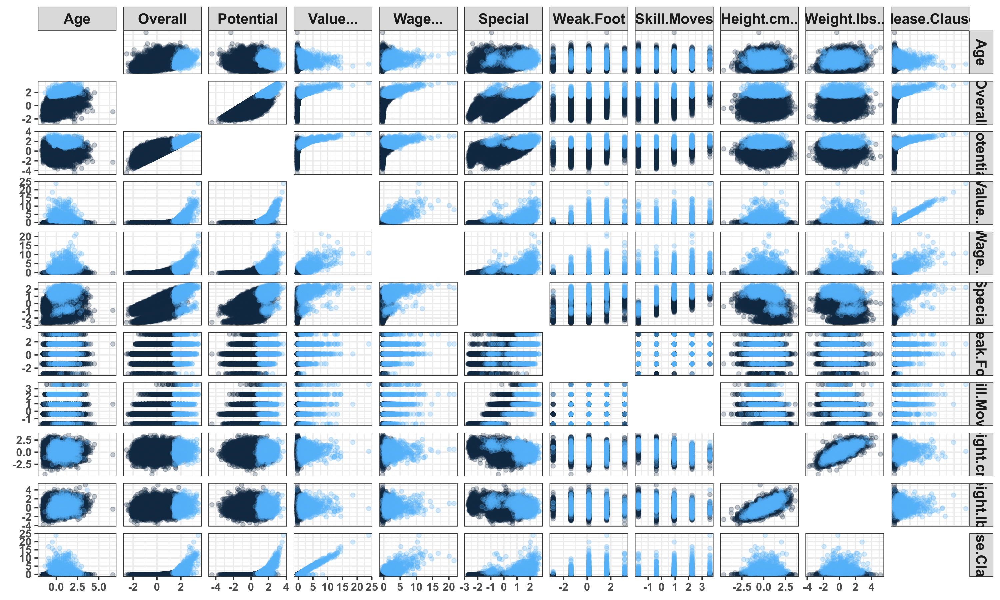

In [ ]:
options(repr.plot.width=25, repr.plot.height=15)

std_ds %>% 
  mutate(clustering = res_kmeans$modelo$cluster) %>% 
  arrange(clustering) %>%
  dplyr::select(clustering, 4:last_col()) %>%
  ggpairs(
    columns = 2:ncol(.),                # solo variables numéricas desde la 4ª a la última
    aes(color = clustering),
    upper = list(continuous = wrap("points", alpha = 0.25, size=3)),
    lower = list(continuous = wrap("points", alpha = 0.25, size=3)),
    diag = list(continuous = "blankDiag")  # elimina histogramas
  ) + tema_custom

In [121]:
pca_3d(ds[-(1:3)], clusters=res_kmeans$mokdelo$cluster, labels=ds$Name, op1=0.01, op2=1)

HTML widgets cannot be represented in plain text (need html)

Por lo que la división pareciera separar jugadores con altos salarios, valores de compra y valores de venta a la par que las mejores métricas de Overall y Potential; de jugadores más baratos y con métricas de desempeño no tan destacables como las anteriores.
<br>
<br>


Comprobemos, pues, dados tales clusters, qué puntos han sido calificados como outliers:

####  K-Medoids

Puesto que el número de clusters es algo arbitrario, aquí se escogerá de manera que se minimice la métrica silueta:

In [19]:
set.seed(0)

encontrar_k_optimo_kmedoids <- function(data, 
                                        k_min = 2, 
                                        k_max = 10, 
                                        graficar = TRUE) {
  
  # Calcular distancias una sola vez
  d <- dist(data)

  # Vector para guardar siluetas
  silhouette_scores <- numeric(k_max)

  for (k in k_min:k_max) {
    pam_model <- pam(d, k = k, diss = TRUE)
    sil <- silhouette(pam_model$clustering, d)
    silhouette_scores[k] <- mean(sil[, 3])
  }

  # Elegir el k óptimo
  k_optimo <- which.max(silhouette_scores)

  # Modelo final con k óptimo
  modelo_final <- pam(d, k = k_optimo, diss = TRUE)

  # Gráfica opcional
  if (graficar) {
    plot(k_min:k_max,
         silhouette_scores[k_min:k_max],
         type = "b",
         xlab = "Número de clusters (k)",
         ylab = "Silhouette promedio",
         main = "Selección óptima de k con Silhouette (k-medoids)")
    abline(v = k_optimo, col = "red", lty = 2)
  }
  
  return(list(
    k_optimo = k_optimo,
    silhouette = silhouette_scores,
    modelo = modelo_final
  ))
}


In [ ]:
colnames(ds)
c("Age", "Overall", "Potential", "Value...", "Wage...", "Reñease.Clause...")

[1] "Name"              "Position"          "Preferred.Foot"   
 [4] "Age"               "Overall"           "Potential"        
 [7] "Value..."          "Wage..."           "Special"          
[10] "Weak.Foot"         "Skill.Moves"       "Height.cm.."      
[13] "Weight.lbs.."      "Release.Clause..."

[1] "Age"               "Overall"           "Potential"        
[4] "Value..."          "Wage..."           "Reñease.Clause..."

$k_optimo
[1] 2

$silhouette
[1] 0.0000000 0.3619319 0.2337095 0.3109296 0.3216671 0.2903848

$modelo
Medoids:
        ID      
[1,]  1971  1971
[2,] 13425 13425
Clustering vector:
    [1] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
   [37] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
   [73] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [109] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [145] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [181] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [217] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [253] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [289] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [325] 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
  [361] 1 1 1 1 1 1

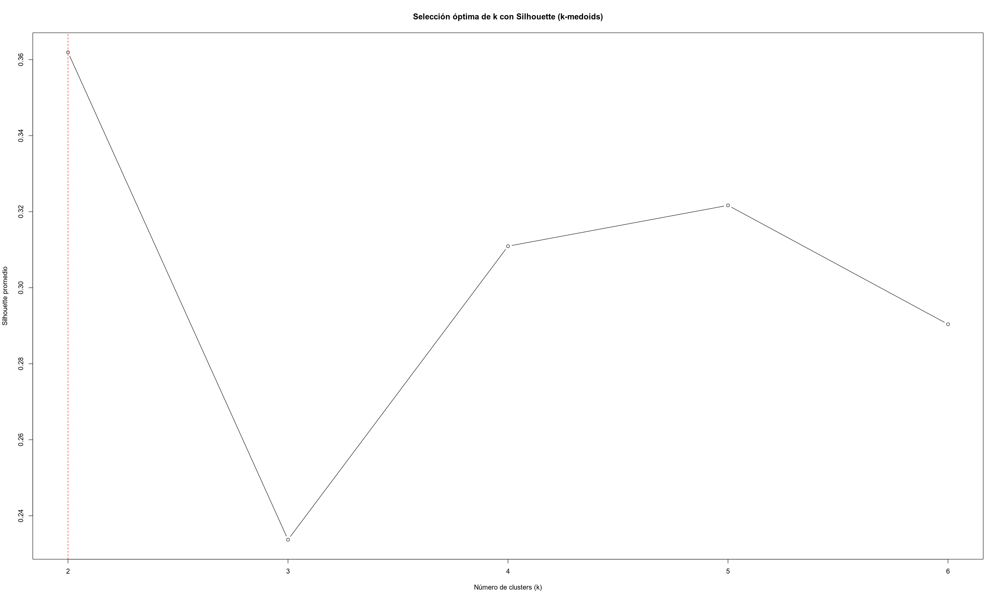

In [24]:
(res_pam <- encontrar_k_optimo_kmedoids(std_ds[c("Age", "Overall", "Potential", "Value...", "Wage...", "Release.Clause...")], k_min = 2, k_max = 6))

Por lo que nuevamente, la mejor elección parece ser un número de clusters igual a 2.

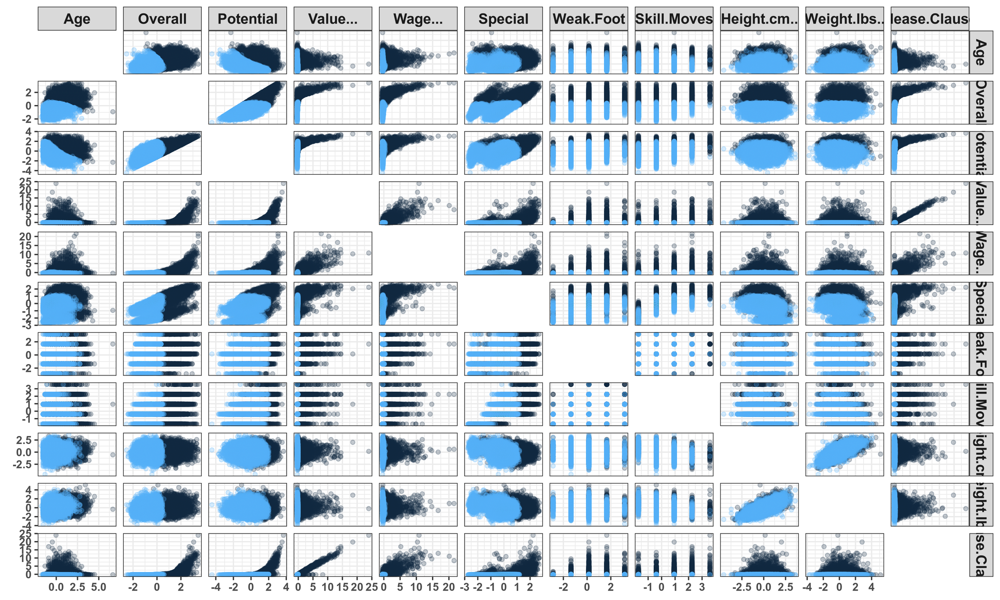

In [25]:
options(repr.plot.width=25, repr.plot.height=15)

std_ds %>% 
  mutate(clustering = res_pam$modelo$cluster) %>% 
  arrange(clustering) %>%
  dplyr::select(clustering, 4:last_col()) %>%
  ggpairs(
    columns = 2:ncol(.),                # solo variables numéricas desde la 4ª a la última
    aes(color = clustering),
    upper = list(continuous = wrap("points", alpha = 0.25, size=3)),
    lower = list(continuous = wrap("points", alpha = 0.25, size=3)),
    diag = list(continuous = "blankDiag")  # elimina histogramas
  ) + tema_custom

Por lo que la división pareciera separar jugadores con altos salarios, valores de compra y valores de venta a la par que las mejores métricas de Overall y Potential; de jugadores más baratos y con métricas de desempeño no tan destacables como las anteriores.

# Extra

### Age

Establezcamos la variable a anlizar:

In [11]:
var_name = "Age"

Comenzemos mostrando la información más relevante obtenida con la función de análisis IQR:

In [12]:
vars_iqr_analysis[[var_name]][1:7]

ERROR: Error: object 'vars_iqr_analysis' not found


Gráficamente:

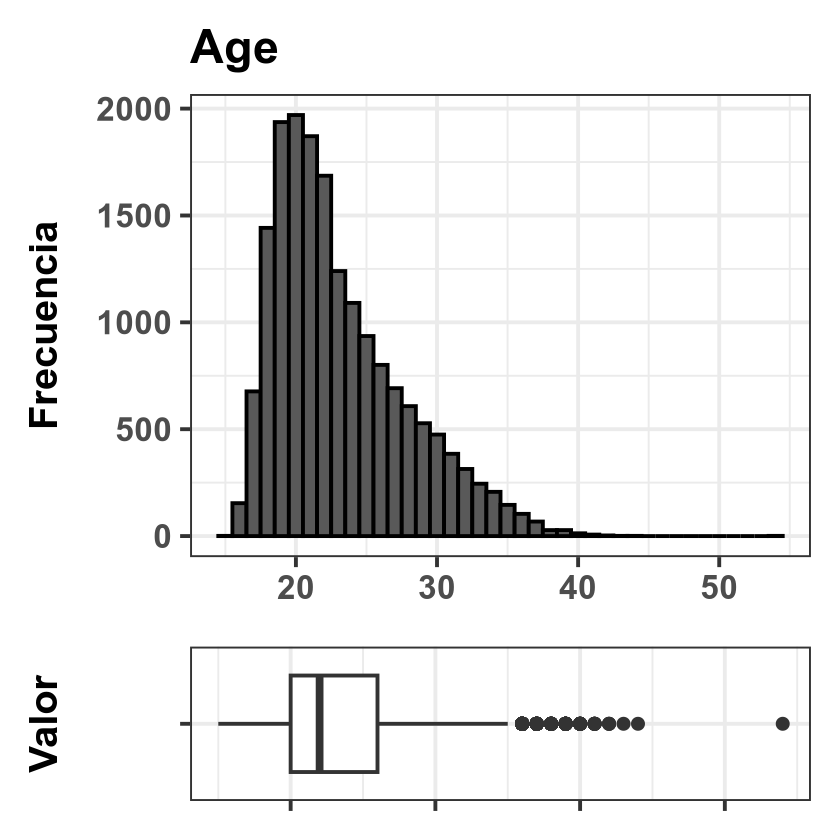

In [13]:
# Crea una lista de gráficos (uno por variable)
indiv_hist_boxplot <- function(ds, var_name) {
  
  d <- ds %>% dplyr::select(all_of(var_name)) %>% dplyr::rename(value = all_of(var_name))
  
  # Histograma
  p1 <- ggplot(d, aes(x = value)) +
    geom_histogram(color = "black", bins=40) +
    theme +
    theme(
      axis.title.x = element_blank()
    ) +
    labs(title = var_name, y = "Frecuencia")
  
  # Boxplot
  p2 <- ggplot(d, aes(y = "", x = value)) +
    geom_boxplot() +
    theme +
    theme(
      axis.title.x = element_blank(),
      axis.text.x = element_blank()
    ) +
    labs(y = "Valor")
  
  # Combina histograma arriba y boxplot abajo en un gráfico vertical
  p1 / p2 + plot_layout(heights = c(3, 1))
}


# options(repr.plot.width=6, repr.plot.height=6)
# ggplot() +
# geom_boxplot(aes(y=ds %>% pull(var_name))) +
# theme +
# labs(y=var_name, title=paste("Boxplot de", var_name))
indiv_hist_boxplot(ds,var_name)

Antes de mostrar cualquier dato, comprobemos el número de valores outliers de cada tipo:

In [ ]:
cat("Número de outliers: ", sum(vars_iqr_analysis[[var_name]]$son.outliers.IQR))
cat("\n")
cat("Número de outliers extremos: ", sum(vars_iqr_analysis[[var_name]]$son.outliers.IQR.extremos))

Número de outliers:  409
Número de outliers extremos:  1

Al contar con un amplio número de outliers normales, visualizaremos solo el extremo:

In [ ]:
ds[vars_iqr_analysis[[var_name]]$son.outliers.IQR.extremos,]

,Name,Position,Preferred.Foot,Age,Overall,Potential,Value...,Wage...,Special,Weak.Foot,Skill.Moves,Height.cm..,Weight.lbs..,Release.Clause...,Best.Overall.Rating
,<fct>,<fct>,<fct>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
15273,22 K. Miura,RES,Right,54,56,56,0,700,1267,4,3,177,158.76,1300000,0


Encontramos, pues, que el futbolista llamado como "22 K. Miura" es el único outlier extremo del dataset, en este caso, representando la edad máxima del mismo, igual a 54 años.

### Overall

Establezcamos la variable a anlizar:

In [17]:
var_name = "Overall"

Comenzemos mostrando la información más relevante obtenida con la función de análisis IQR:

In [18]:
vars_iqr_analysis[[var_name]][1:7]

$iqr
[1] 11

$cuartil.primero
[1] 58

$cuartil.tercero
[1] 69

$extremo.superior.outlier.IQR
[1] 85.5

$extremo.superior.inferior.IQR
[1] 52.5

$extremo.superior.outlier.IQR.extremo
[1] 102

$extremo.superior.inferior.IQR.extremo
[1] 36

Gráficamente:

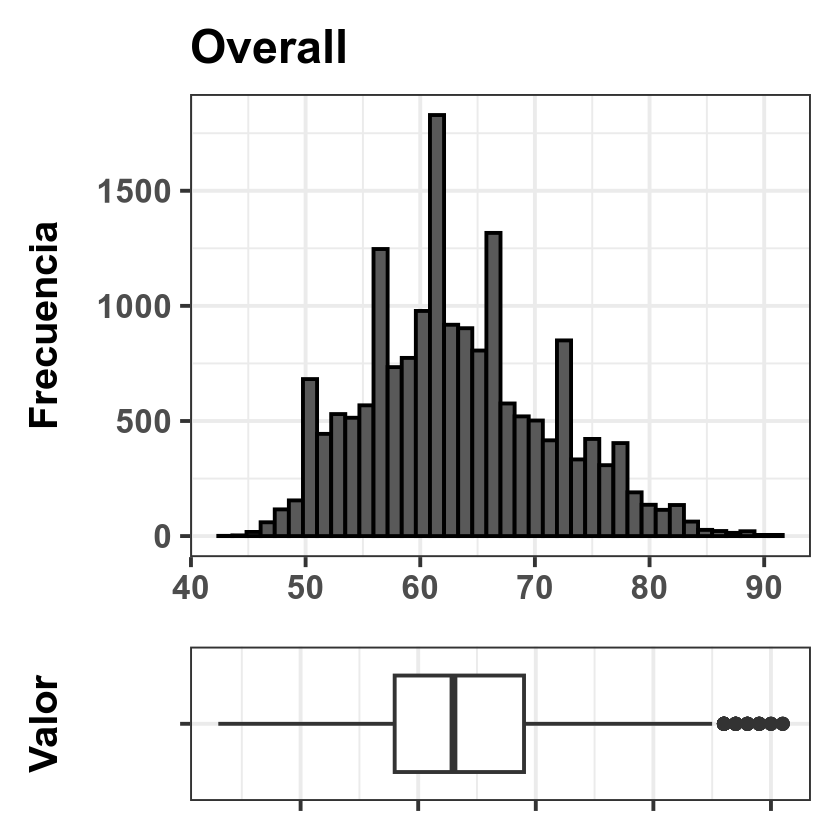

In [ ]:
indiv_hist_boxplot(ds,var_name)

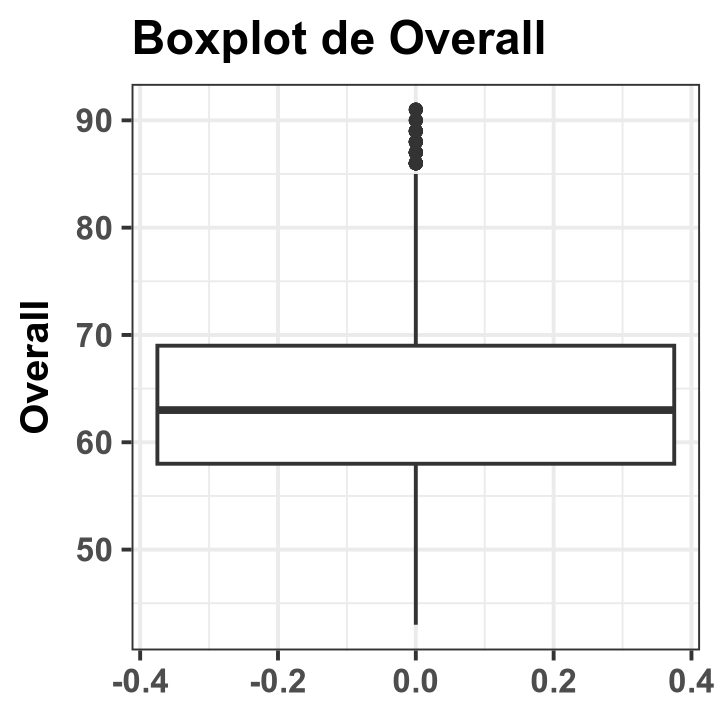

In [104]:
options(repr.plot.width=6, repr.plot.height=6)
ggplot() +
geom_boxplot(aes(y=ds %>% pull(var_name))) +
theme +
labs(y=var_name, title=paste("Boxplot de", var_name))

Antes de mostrar cualquier dato, comprobemos el número de valores outliers de cada tipo:

In [92]:
cat("Número de outliers: ", sum(vars_iqr_analysis[[var_name]]$son.outliers.IQR))
cat("\n")
cat("Número de outliers extremos: ", sum(vars_iqr_analysis[[var_name]]$son.outliers.IQR.extremos))

Número de outliers:  1546
Número de outliers extremos:  0